##### Importación de librerias


In [1]:
from pathlib import Path
from warnings import simplefilter

import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns

import matplotlib.dates as mdates
from statsmodels.tsa.seasonal import seasonal_decompose, STL
from sklearn.metrics import mean_squared_error as MSE, r2_score, mean_absolute_percentage_error as MAPE
from scipy.signal import periodogram
# Stats packages
import statsmodels.api as sm
from prophet.plot import add_changepoints_to_plot
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D

from sklearn.metrics import mean_absolute_error, mean_squared_error

import warnings
warnings.filterwarnings("ignore")
from prophet import Prophet
from prophet.plot import plot_plotly
import plotly.offline as py
py.init_notebook_mode()

simplefilter("ignore")

/home/aburgos/anaconda3/lib/python3.9/site-packages/statsmodels/tsa/base/tsa_model.py:7: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import (to_datetime, Int64Index, DatetimeIndex, Period,
/home/aburgos/anaconda3/lib/python3.9/site-packages/statsmodels/tsa/base/tsa_model.py:7: FutureWarning: pandas.Float64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import (to_datetime, Int64Index, DatetimeIndex, Period,


##### Configuración de matplotlib

In [2]:
# Set Matplotlib defaults
plt.style.use("seaborn-whitegrid")
plt.rc("figure", autolayout=True, figsize=(30, 30))
plt.rc(
    "axes",
    labelweight="bold",
    labelsize="large",
    titleweight="bold",
    titlesize=16,
    titlepad=10,
)
plot_params = dict(
    color="0.75",
    style=".-",
    markeredgecolor="0.25",
    markerfacecolor="0.25",
    legend=False,
)
%config InlineBackend.figure_format = 'retina'
plt.style.use('seaborn-deep')

##### Ocultar advertencias

In [3]:
import logging
logging.getLogger('prophet').setLevel(logging.WARNING)
import os
class suppress_stdout_stderr(object):
    '''
    A context manager for doing a "deep suppression" of stdout and stderr in
    Python, i.e. will suppress all print, even if the print originates in a
    compiled C/Fortran sub-function.
       This will not suppress raised exceptions, since exceptions are printed
    to stderr just before a script exits, and after the context manager has
    exited (at least, I think that is why it lets exceptions through).

    '''
    def __init__(self):
        # Open a pair of null files
        self.null_fds = [os.open(os.devnull, os.O_RDWR) for x in range(2)]
        # Save the actual stdout (1) and stderr (2) file descriptors.
        self.save_fds = [os.dup(1), os.dup(2)]

    def __enter__(self):
        # Assign the null pointers to stdout and stderr.
        os.dup2(self.null_fds[0], 1)
        os.dup2(self.null_fds[1], 2)

    def __exit__(self, *_):
        # Re-assign the real stdout/stderr back to (1) and (2)
        os.dup2(self.save_fds[0], 1)
        os.dup2(self.save_fds[1], 2)
        # Close the null files
        for fd in self.null_fds + self.save_fds:
            os.close(fd)

##### Importación de datos
Se cargan los datos en un dataframe de pandas mediante la función pandas.read_csv.

In [4]:

df = pd.read_csv('voltajes_marzo.csv')

In [5]:
df

,fec_fre,ip_fre,vol_fre,nom_fre,loc_fre
0,2022-03-01 00:00:01,10.0.1.100,11.04,Endpoint El Troje,El Troje
1,2022-03-01 00:00:01,10.0.1.101,11.81,Gateway Pulpito,Repetidora Motil..n
2,2022-03-01 00:00:01,10.0.1.102,12.57,Endpoint Pulpito,Repetidora Pulpito
3,2022-03-01 00:00:01,10.0.1.103,12.70,Gateway Motilon,Repetidora Morasurco1
4,2022-03-01 00:00:01,10.0.1.104,12.57,Endpoint Motilon,Repetidora Motilon
...,...,...,...,...,...
131118,2022-03-14 22:15:02,10.0.1.98,11.81,Endpoint Altamira - El,Altamira
131119,2022-03-14 22:15:02,10.0.1.99,11.68,Gateway El Troje,Repetidora El Pulpito
131120,2022-03-14 22:15:02,10.0.3.57,12.44,Gateway La Nieve,Repetidora Paja Blanca
131121,2022-03-14 22:15:02,10.0.4.7,0.00,Gateway San Jose,Repetidora San Jose


##### Verificación de datos nulos

In [6]:
df[df['vol_fre'].isnull()]

,fec_fre,ip_fre,vol_fre,nom_fre,loc_fre


##### Identificación de estaciones mediante su dirección IP

In [7]:
uniqueValues = df['ip_fre'].unique()
uniqueValues

array(['10.0.1.100', '10.0.1.101', '10.0.1.102', '10.0.1.103',
       '10.0.1.104', '10.0.1.105', '10.0.1.106', '10.0.1.109',
       '10.0.1.110', '10.0.1.113', '10.0.1.114', '10.0.1.121',
       '10.0.1.122', '10.0.1.123', '10.0.1.124', '10.0.1.127',
       '10.0.1.128', '10.0.1.129', '10.0.1.130', '10.0.1.131',
       '10.0.1.132', '10.0.1.133', '10.0.1.134', '10.0.1.139',
       '10.0.1.140', '10.0.1.141', '10.0.1.142', '10.0.1.143',
       '10.0.1.144', '10.0.1.147', '10.0.1.149', '10.0.1.157',
       '10.0.1.158', '10.0.1.159', '10.0.1.160', '10.0.1.161',
       '10.0.1.162', '10.0.1.165', '10.0.1.166', '10.0.1.167',
       '10.0.1.168', '10.0.1.169', '10.0.1.170', '10.0.1.171',
       '10.0.1.172', '10.0.1.175', '10.0.1.176', '10.0.1.177',
       '10.0.1.179', '10.0.1.180', '10.0.1.185', '10.0.1.186',
       '10.0.1.187', '10.0.1.188', '10.0.1.21', '10.0.1.22', '10.0.1.23',
       '10.0.1.24', '10.0.1.43', '10.0.1.44', '10.0.1.51', '10.0.1.52',
       '10.0.1.53', '10.0.1.54', '1

##### Exploración básica de datos

In [8]:
df.describe()

,vol_fre
count,131123.000000
mean,11.684376
std,2.677465
min,0.000000
25%,11.680000
50%,12.060000
75%,12.700000
max,16.380000


In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 131123 entries, 0 to 131122
Data columns (total 5 columns):
 #   Column   Non-Null Count   Dtype  
---  ------   --------------   -----  
 0   fec_fre  131123 non-null  object 
 1   ip_fre   131123 non-null  object 
 2   vol_fre  131123 non-null  float64
 3   nom_fre  127748 non-null  object 
 4   loc_fre  128358 non-null  object 
dtypes: float64(1), object(4)
memory usage: 5.0+ MB


In [10]:
print(df['fec_fre'].head())

0    2022-03-01 00:00:01
1    2022-03-01 00:00:01
2    2022-03-01 00:00:01
3    2022-03-01 00:00:01
4    2022-03-01 00:00:01
Name: fec_fre, dtype: object


La columna fec_fre es de tipo objeto, por lo tanto debe ser convertida a tipo datetime64

In [11]:
df['fec_fre'] = pd.to_datetime(df['fec_fre'], infer_datetime_format=True)

In [12]:
print(df['fec_fre'].head())

0   2022-03-01 00:00:01
1   2022-03-01 00:00:01
2   2022-03-01 00:00:01
3   2022-03-01 00:00:01
4   2022-03-01 00:00:01
Name: fec_fre, dtype: datetime64[ns]


#### Descomposición de series temporales
La descomposición de series temporales es el proceso de separar los datos de las series temporales en sus componentes principales. Estos componentes incluyen una tendencia potencial (aumento o descenso general de la media), estacionalidad (un ciclo recurrente) y el residual aleatorio restante. Las tendencias y la estacionalidad no siempre están presentes en los datos dependientes del tiempo. Los modelos de series de tiempo asumen que los datos son estacionarios y solo el componente residual satisface las condiciones de estacionariedad.
La descomposición proporciona un modelo abstracto útil para pensar en series temporales en general y para comprender mejor los problemas durante el análisis y la previsión de series temporales.

#### Componentes de una serie temporal
Una serie de tiempo dada consta de tres componentes sistemáticos que incluyen tendencia, estacionalidad y un componente no sistemático llamado ruido. Estos componentes se definen de la siguiente manera:

#### Tendencia
El componente de tendencia de una serie de tiempo representa un cambio persistente a largo plazo en la media de la serie. La tendencia es la parte de movimiento más lento de una serie, la parte que representa la mayor escala de tiempo de importancia.

<img src="https://i.imgur.com/ZdS4ZoJ.png" alt="Getting started" style="width:450;height:260px;" />

#### Estacionalidad
Se dice que una serie de tiempo exhibe estacionalidad siempre que haya un cambio regular y periódico en la media de la serie. Los cambios estacionales generalmente siguen el reloj y el calendario; las repeticiones durante un día, una semana o un año son comunes. La estacionalidad a menudo está impulsada por los ciclos del mundo natural durante días y años o por convenciones de comportamiento social en torno a fechas y horas.

<img src="https://i.imgur.com/ViYbSxS.png" alt="Getting started" style="width:450;height:260px;" />

#### Ruido: 
Es la variación aleatoria en la serie.

##### Nivel
Es el valor promedio en la serie.

##### Combinación de componentes de series temporales
Se considera que una serie es un agregado o una combinación de estos componentes. Todas las series tienen un nivel y un ruido y los componentes de tendencia y estacionalidad son opcionales. Por lo tanto es útil pensar que los componentes pueden ser combinados para formar una serie temporal, y estas combinaciones pueden ser de forma aditiva o de forma multiplicativa.
##### Estacionalidad aditiva
Es bastante raro que las series temporales reales tengan valores máximos y mínimos constantes y, en cambio, normalmente vemos algún tipo de tendencia general, como un aumento o una disminución a lo largo del tiempo. A continuación se muestra un ejemplo de una estacionalidad aditiva.

<img src="https://miro.medium.com/max/1400/1*7lgUd6sVJLi-kqiLEp4FxA.jpeg" alt="Getting started" style="width:450;height:260px;" />

Por lo tanto, es posible modelar series de tiempo aditivas usando la siguiente ecuación simple: 
Y[t] = T[t] + S[t] + e[t] 

Donde:

Y[t]: La función de serie temporal. 

T[t]: Tendencia (tendencia general a subir o bajar) 

S[t]: Estacionalidad (patrón cíclico que ocurre a intervalos regulares) 

e[t]: Residual (ruido aleatorio en los datos que no se tiene en cuenta en la tendencia o estacionalidad)

##### Estacionalidad multiplicativa 
El otro tipo de estacionalidad que se puede encontrar en datos de series de tiempo es multiplicativo. En este tipo, la amplitud de la estacionalidad se vuelve más grande o más pequeña según la tendencia. A continuación se muestra un ejemplo de estacionalidad multiplicativa.

<img src="https://miro.medium.com/max/1400/1*2iBhF2SJoMtLu1UXSS3VrQ.jpeg" alt="Getting started" style="width:450;height:260px;" />

Se puede modelar esto con una ecuación similar al modelo aditivo simplemente intercambiando las sumas por multiplicaciones:

Y[t] = T[t] *S[t] *e[t]

##### La descomposición como herramienta

La descomposición se usa principalmente para el análisis de series de tiempo y, como herramienta de análisis, se puede usar para informar a los modelos de pronóstico sobre el problema. Proporciona una forma estructurada de pensar sobre un problema de pronóstico de series de tiempo, tanto en términos generales de complejidad de modelado como específicamente en términos de cómo capturar mejor cada uno de estos componentes en un modelo dado.


##### Visualización de datos

Trazar una gráfica nos ayuda a ver si hay una tendencia, un ciclo estacional, valores atípicos y más. Nos da una idea de los datos. Para realizar un gráfico se utiliza la siguiente función:

In [13]:
def visualización(df_region, fig):
    plt.plot(df_region["fec_fre"],df_region["vol_fre"])
    nombre = " " if pd.isnull(df_region["nom_fre"].iat[0]) else df_region["nom_fre"].iat[0]
    plt.title(nombre+" "+region)  
    plt.xticks(rotation=45)
    plt.margins(0)
    plt.ylabel('Voltaje')
    fig.xaxis.set_major_locator(mdates.DayLocator(interval=1))

##### Periodograma
Un periodograma nos dice la fuerza de las frecuencias en una serie de tiempo, esta información es bastante útil, pues será utilizada en el modelo de machine learning.


In [14]:
def plot_periodogram(ts, detrend='linear', ax=None):
    fs = pd.Timedelta("1Y") / pd.Timedelta("1D")
    freqencies, spectrum = periodogram(
        ts,
        fs=fs*96,
        detrend=detrend,
        window="boxcar",
        scaling='spectrum',
    )
    if ax is None:
        _, ax = plt.subplots()
    ax.step(freqencies, spectrum, color="purple")
    ax.set_xscale("log")
    ax.set_xticks([52, 104,365,730,1460,8760])
    ax.set_xticklabels(
        [
            "Semanalmente (52)",
            "Semi-semanalmente (104)",
            "Diario(365)",
            "Medio dia(730)",
            "6 horas(1460)",
            "1 hora(8760)",            
        ],
        rotation=30,
    )
    ax.ticklabel_format(axis="y", style="sci", scilimits=(0, 0))
    ax.set_ylabel("Varianza")
    ax.set_title("Periodograma")
    return ax


##### Detección de anomalias.
Una anomalia es una observación que está numéricamente distante del resto de los datos o, en otras palabras, es un valor que está fuera del rango. Las anomalias pueden cambiar drásticamente los resultados del análisis de datos y el modelado estadístico, por lo que es importante identificarlas y eliminarlas. Una manera fácil de identificar estos valores atípicos es trazar una gráfica y observar los valores que estan fuera de lo normal. A continuación se crean 2 funciones para identificar valores atípicos: la primera es una gráfica de densidad, y la segunda una gráfica de densidad ajustada a un modelo de regresión lineal. 

In [15]:
def outliers(df_region ):    
    try:
        sns.kdeplot(data=df_region['vol_fre'], shade=True) 
        plt.title("Gráfico de densidad")  
        plt.xlabel('Voltaje')
        plt.ylabel('Densidad')
    except:
        print("An exception occurred") 


In [16]:
def outliers_lineal(df_region):
    count_voltdf = pd.DataFrame(df_region['vol_fre'].value_counts()).reset_index() 
    try:
        sns.regplot(x="vol_fre",y="index", data=count_voltdf, robust=True)
        plt.title("Gráfico de densidad")  
        plt.xlabel('Conteo')
        plt.ylabel('Voltaje')
    except:
        print("An exception occurred")   
    

Se utiliza el siguiente código para eliminar valores atípicos:

In [17]:
def remove_outliers(df_region, fig2):
    ips=["10.0.1.100","10.0.1.114","10.0.1.142","10.0.1.179","10.0.1.180","10.0.1.80","10.0.1.96","10.0.1.98","10.0.2.15","10.0.2.16","10.0.3.231","10.0.3.32","10.0.3.58","10.0.3.65","10.0.3.66"]
    if df_region["ip_fre"].iat[0] in ips:
        df_regionM = df_region.drop(df_region[df_region['vol_fre']<1].index)    
    else:
        df_regionM=df_region

    plt.plot(df_regionM["fec_fre"],df_regionM["vol_fre"])
    nombre = " " if pd.isnull(df_regionM["nom_fre"].iat[0]) else df_regionM["nom_fre"].iat[0]
    plt.title(nombre+" "+region+"\n(Gráfico sin anomalias)")  
    plt.xticks(rotation=45)
    plt.margins(0)
    plt.ylabel('Voltaje')
    fig2.xaxis.set_major_locator(mdates.DayLocator(interval=1))
    return df_regionM

Se descompone cada serie de tiempo en su tendencia, estacionalidad y residuo mediante el siguiente código:

In [18]:
def descomposition(df_regionM, plt):
    df_regionM.set_index('fec_fre', inplace=True)
    df_regionM.sort_index(inplace=True)

    analysis = df_regionM[['vol_fre']].copy()
    decompose_result_mult = seasonal_decompose(analysis, period=96, model="additive")
    trend = decompose_result_mult.trend
    seasonal = decompose_result_mult.seasonal
    residual = decompose_result_mult.resid
    plt.plot(trend)
    plt.title("Descomposición de serie temporal\n(Tendencia)")  
    plt.margins(0)
    plt.subplot(5, 2, 7)
    plt.plot(seasonal)
    plt.title("Descomposición de serie temporal\n(Estacionalidad)")  
    plt.margins(0)


Para el pronóstico de series de tiempo se utiliza el procedimiento Prophet. Para evaluar el desempeño del modelo de regresión se utiliza el MAE y el RMSE

\begin{aligned}
&\text { RMSE }=\sqrt{\frac{\sum\left(y_{i}-y_{p}\right)^{2}}{n}} \\
&\text { MAE }=\frac{\left|\left(y_{i}-y_{p}\right)\right|}{n} \\
&y_{i}=\text { actual value } \\
&y_{p}=\text { predicted value } \\
&n=\text { number of observations/rows }
\end{aligned}


In [19]:
def forecast(df_regionM, fig5):
    nombre = " " if pd.isnull(df_region["nom_fre"].iat[0]) else df_region["nom_fre"].iat[0]
    df = df_regionM.reset_index().rename(columns={'fec_fre': 'ds',
                        'vol_fre': 'y'})[['ds', 'y']]
    df_train=df.loc[(df['ds'] < "2022-03-13")]
    df_test=df.loc[(df['ds'] >= "2022-03-13")]
    df_dates=df[["ds"]]
    my_model = Prophet(interval_width=0.95,changepoint_range=0.9)
    with suppress_stdout_stderr():
        my_model.fit(df_train)
        
    forecast = my_model.predict(df_dates)

    fig= my_model.plot(forecast, ax=fig5, xlabel="Fecha", ylabel="Voltaje");
    ax = fig.gca()
    a = add_changepoints_to_plot(fig.gca(), my_model, forecast)
    plt.title(nombre+" "+region) 
    plt.margins(0) 
    handles, labels = plt.gca().get_legend_handles_labels() 
    line = Line2D([0], [0], label='Pronóstico', color='tab:blue')
    line2 = Line2D([0], [0], label='Tendencia', color='red')
    line4 = Line2D([0], [0], label='Puntos de cambio', color='red', linestyle='--' )
    line5 = Line2D([0], [0], label='Valores observados', color='black', linestyle=':')
    

    handles.extend([line,line2, line4, line5])

    plt.legend(handles=handles, loc='lower center', frameon=True, fancybox=True,ncol=5)
    
    fig6 = plt.subplot(5, 2, 9)
    
    df_predicted= forecast[['yhat', 'ds']].loc[(df['ds'] >= "2022-03-13")].set_index("ds")
    yhat_lower= forecast[['yhat_lower', 'ds']].loc[(df['ds'] >= "2022-03-13")].set_index("ds")
    yhat_upper= forecast[['yhat_upper', 'ds']].loc[(df['ds'] >= "2022-03-13")].set_index("ds")
    df_test=df_test.set_index("ds")
    plt.plot(df_test, label='Valores observados', color="red")
    plt.plot(df_predicted, label='Valores pronosticados')
    plt.title(nombre+" "+region)  
    plt.margins(0)
    plt.ylabel('Voltaje')
    plt.xlabel('Fecha')
    
    
    plt.fill_between(yhat_lower.index, yhat_upper.yhat_upper, yhat_lower.yhat_lower, alpha=0.2)

    mae = mean_absolute_error(df_test, df_predicted)
    rmse = mean_squared_error(df_test, df_predicted , squared=False)
    mape = MAPE(df_test, df_predicted)*100

    MAE='MAE: %.3f' % mae
    RMSE='RMSE: %.3f' % rmse
    Mape='MAPE: %.3f' % mape
    L1 = plt.legend(loc='lower center', frameon=True, fancybox=True,ncol=2)
    ax = plt.gca().add_artist(L1)
    handles = [
    Line2D([0], [0], color='white'),
    Line2D([0], [0], color='white'),
    Line2D([0], [0], color='white')]
    labels_ = []
    labels_.append(RMSE )
    labels_.append(MAE)
    labels_.append(Mape+"%")

    plt.legend(handles, labels_, loc='upper left', fancybox=True,  frameon=True)
    plt.show()

        

A continuación se itera por cada una de las estaciones:

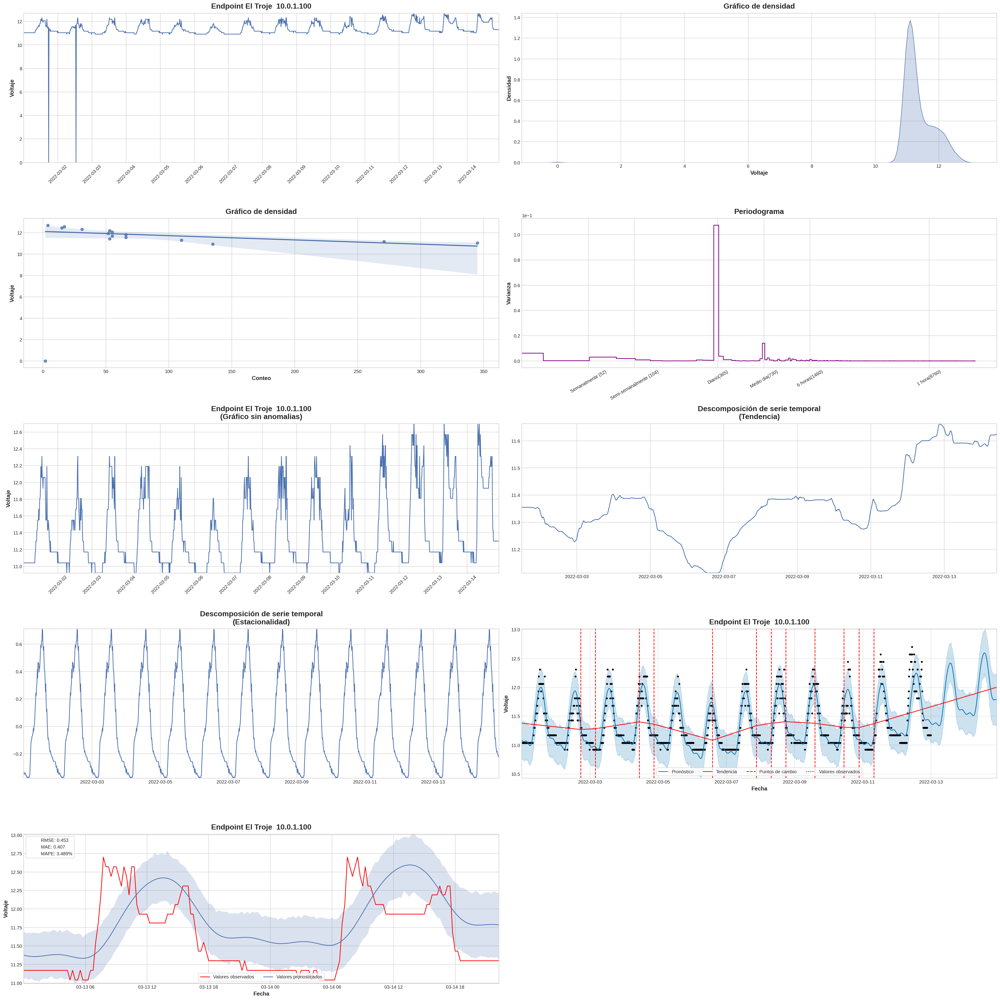

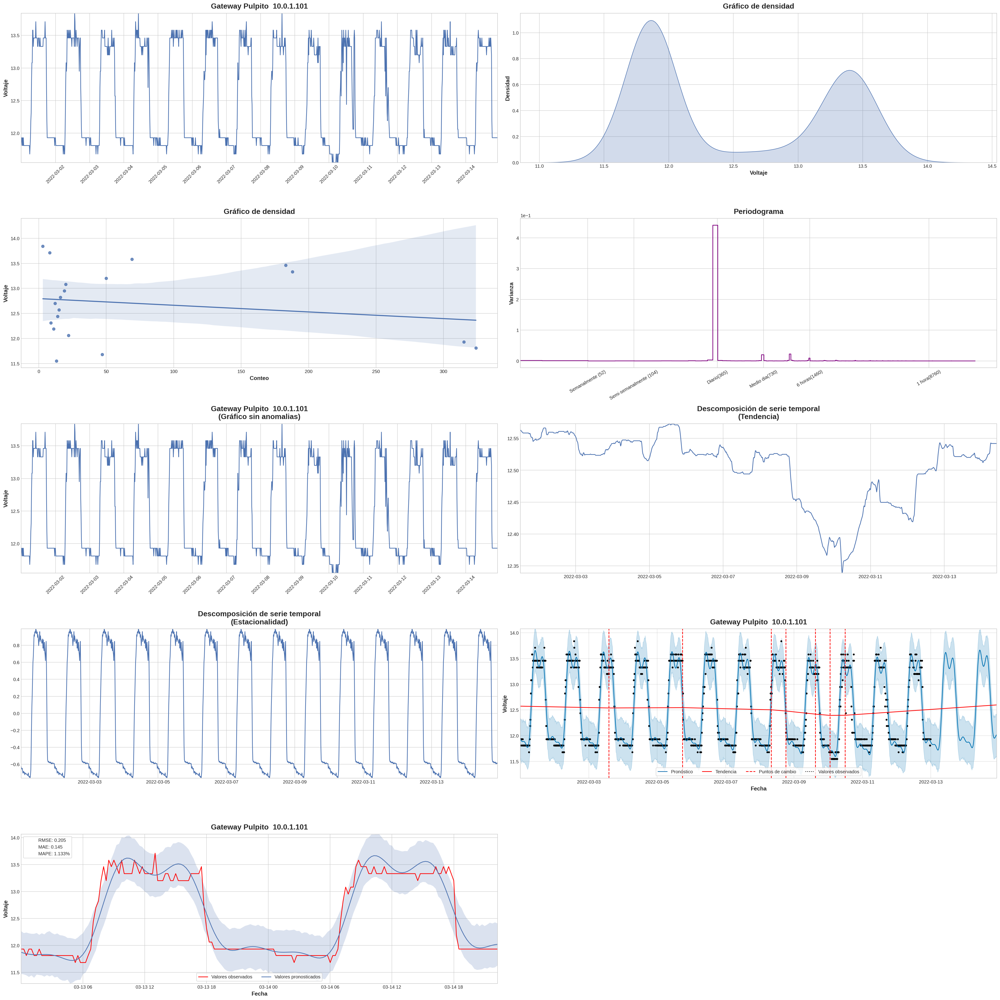

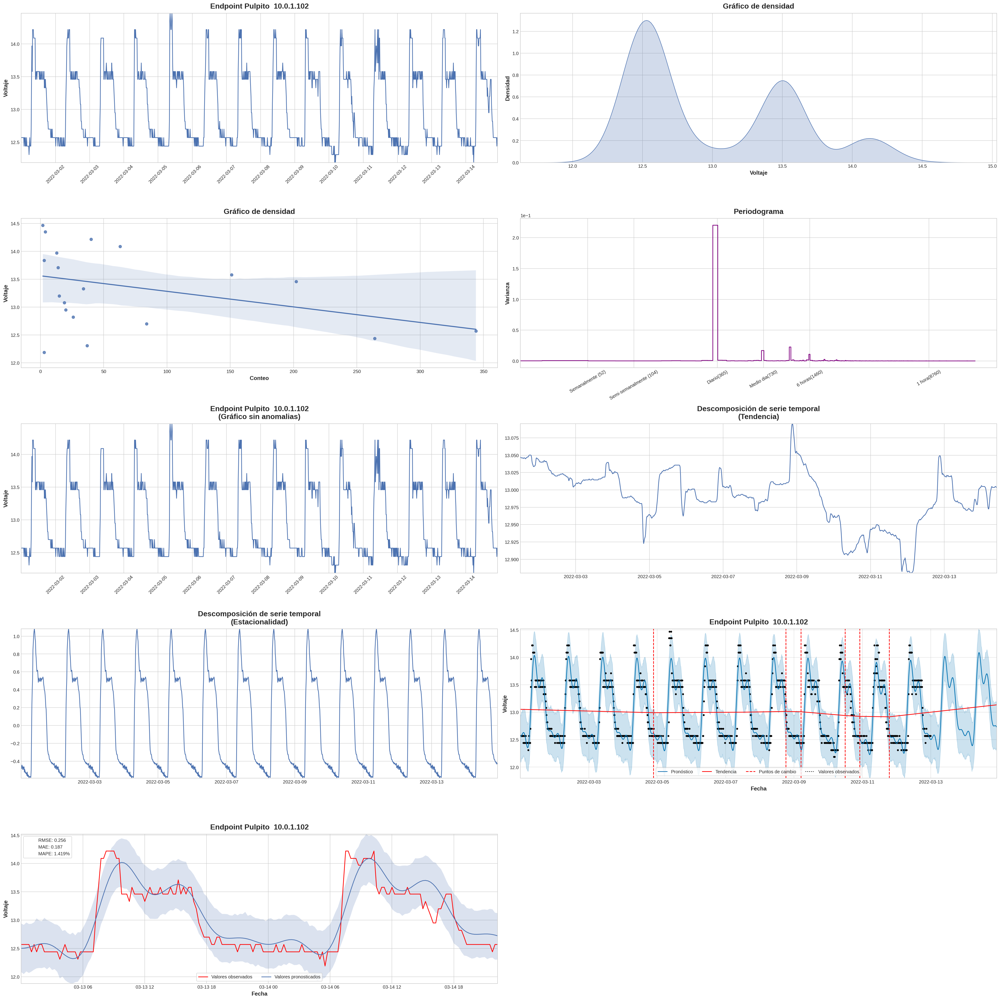

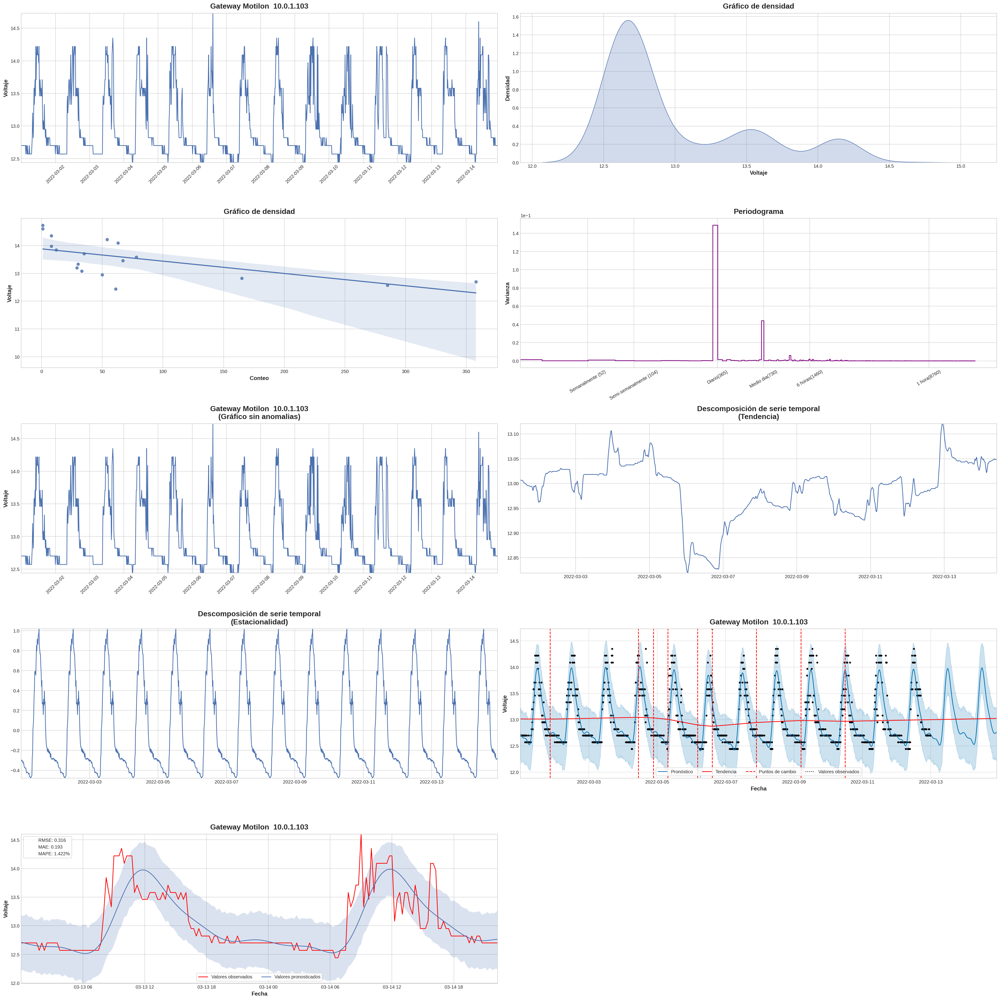

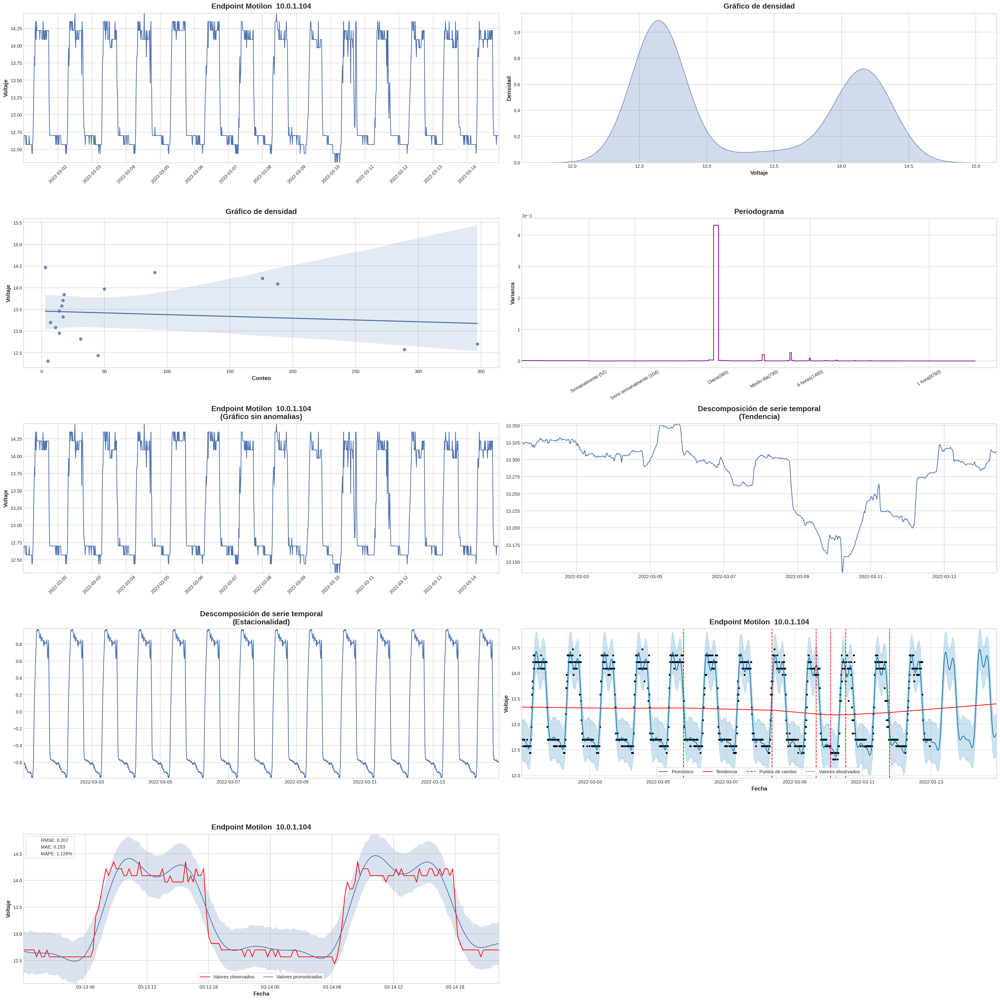

...

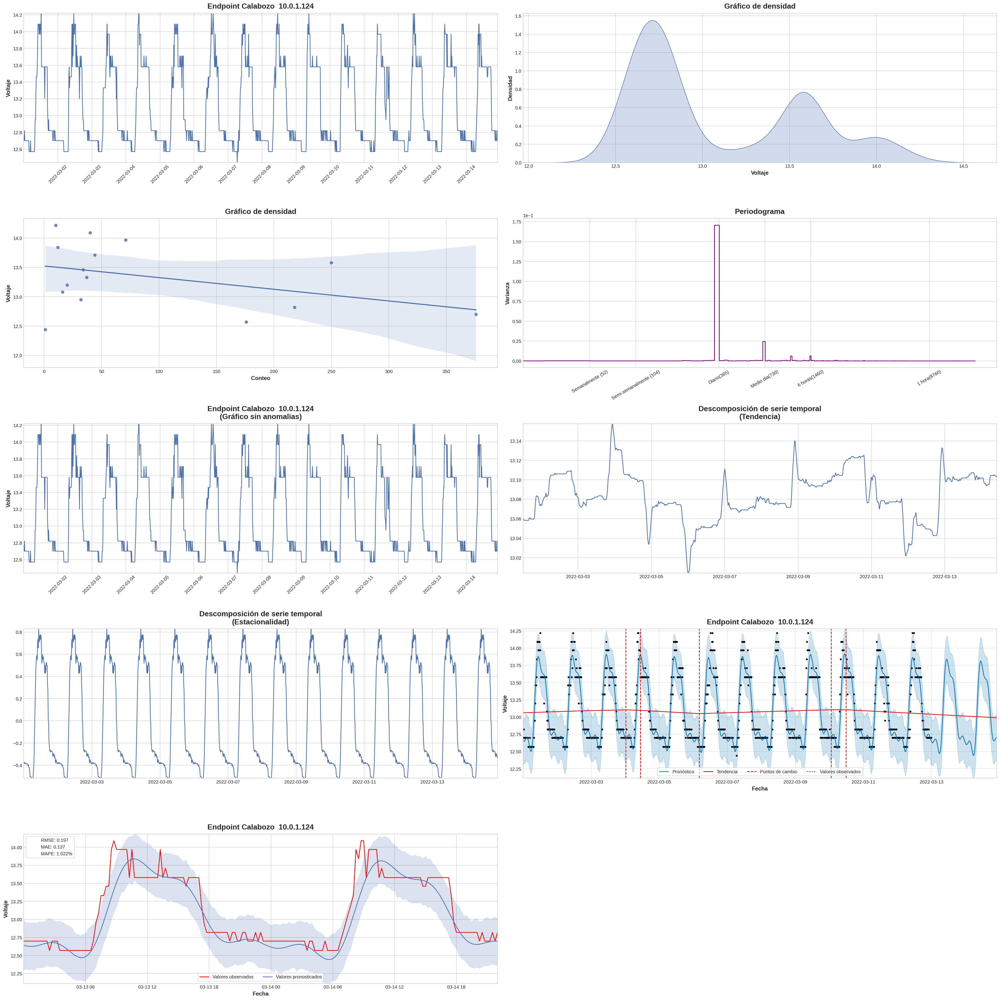

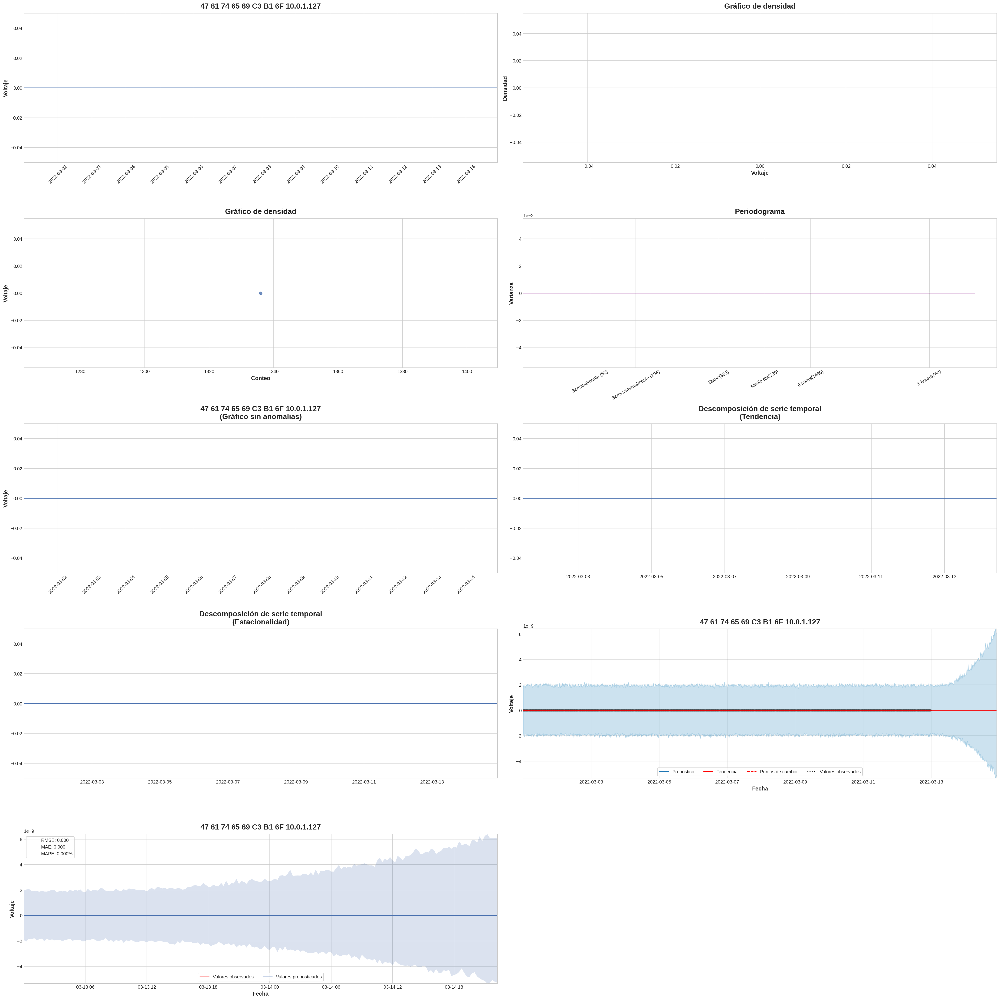

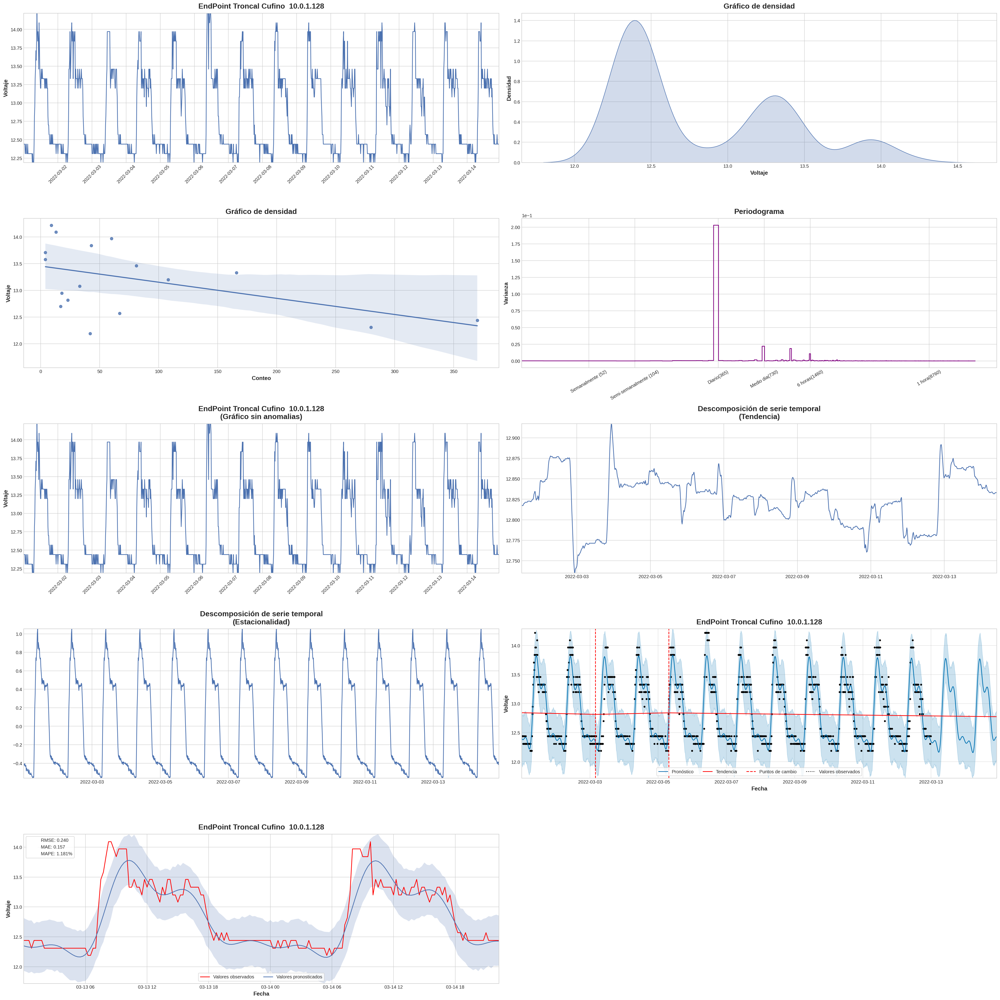

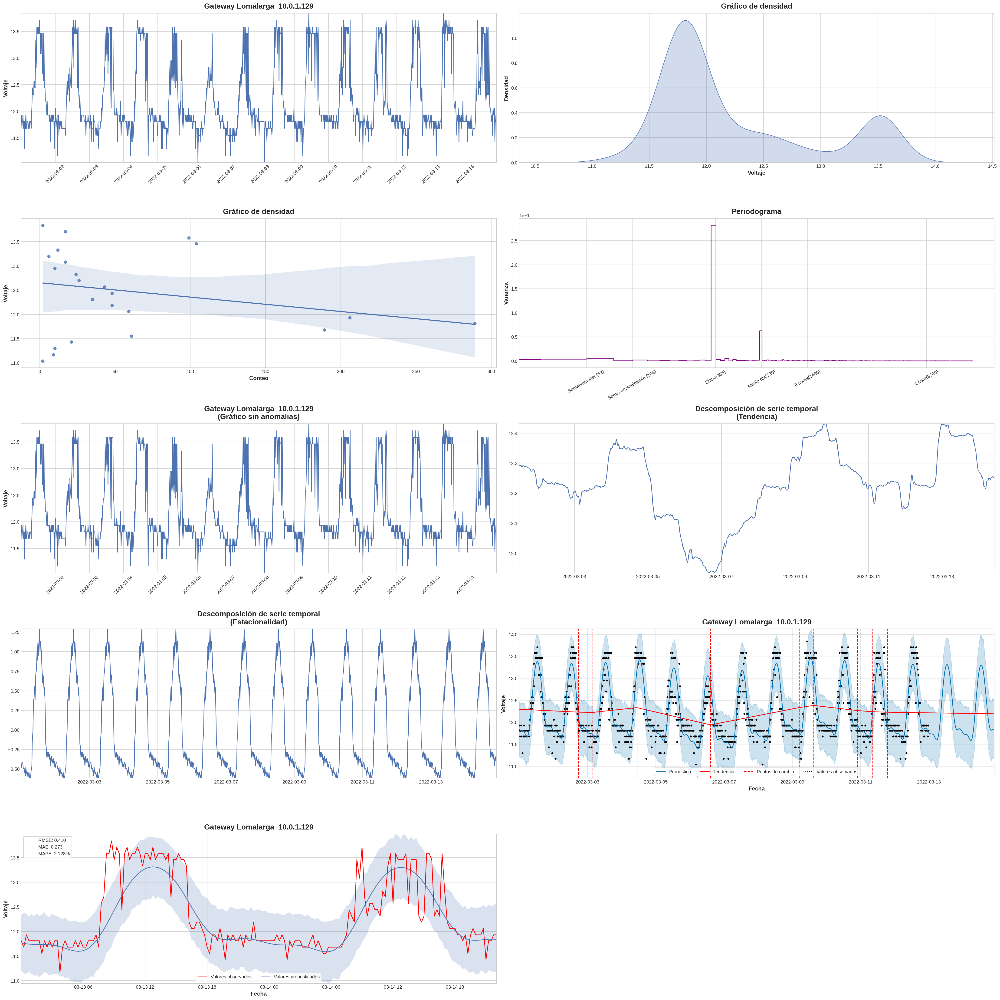

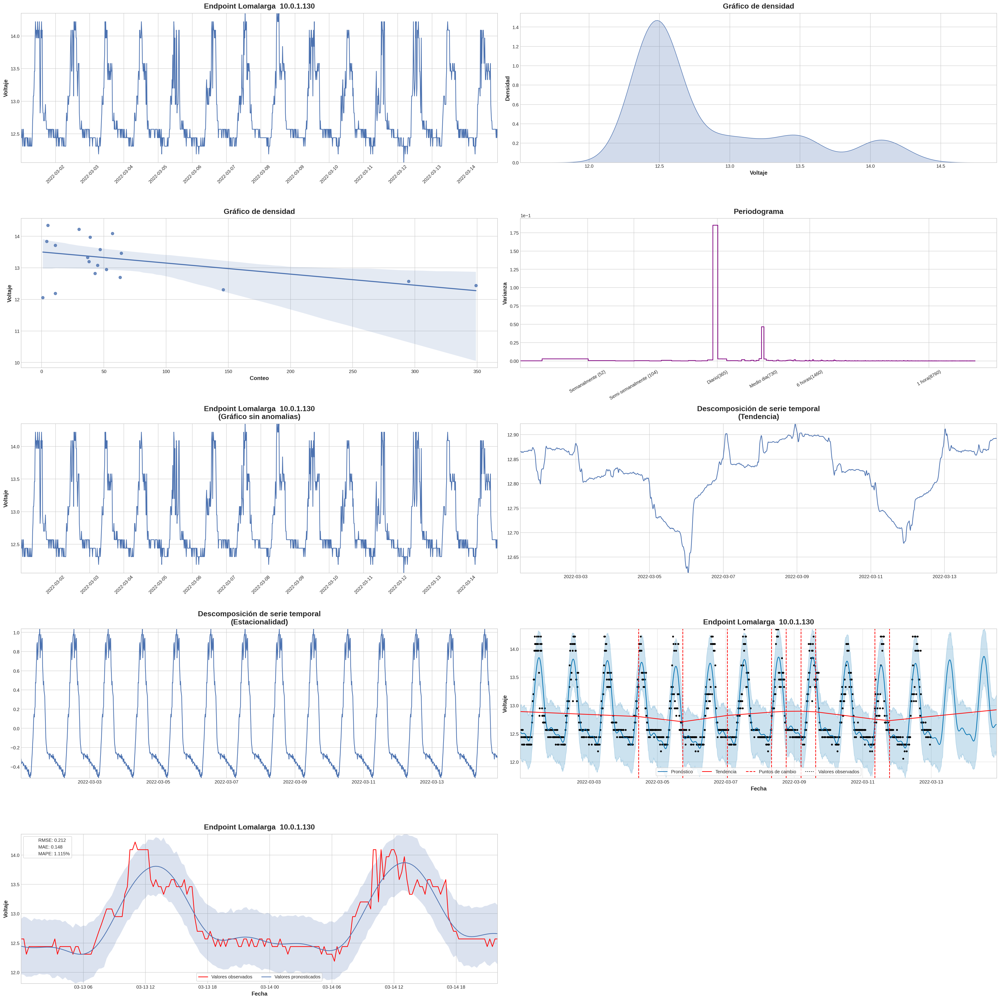

An exception occurred


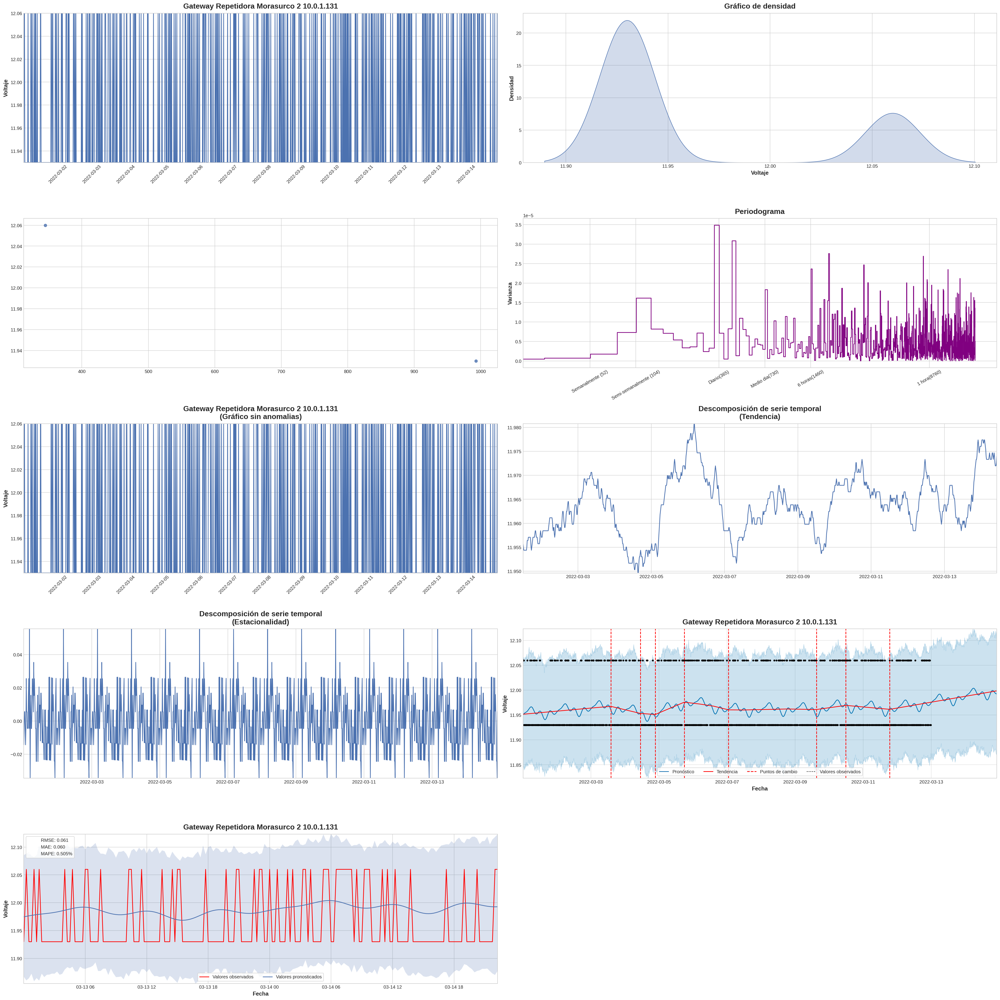

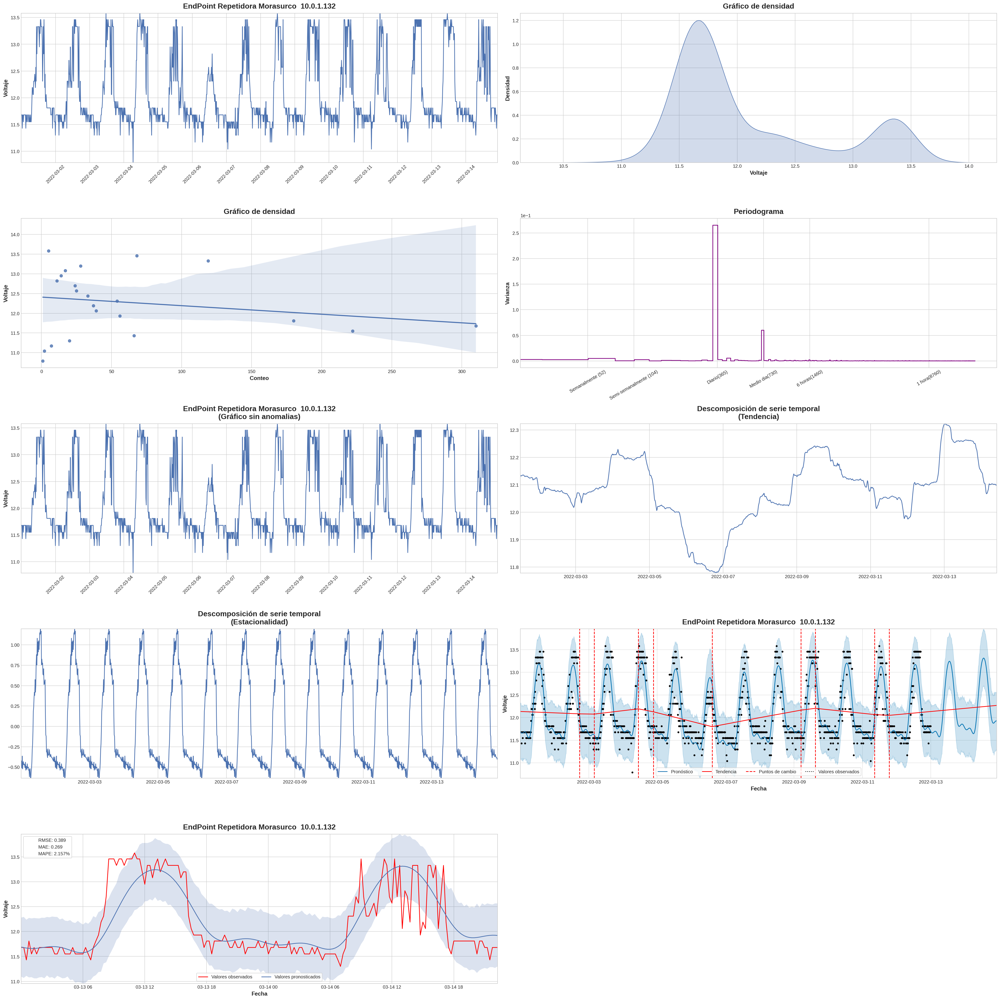

An exception occurred


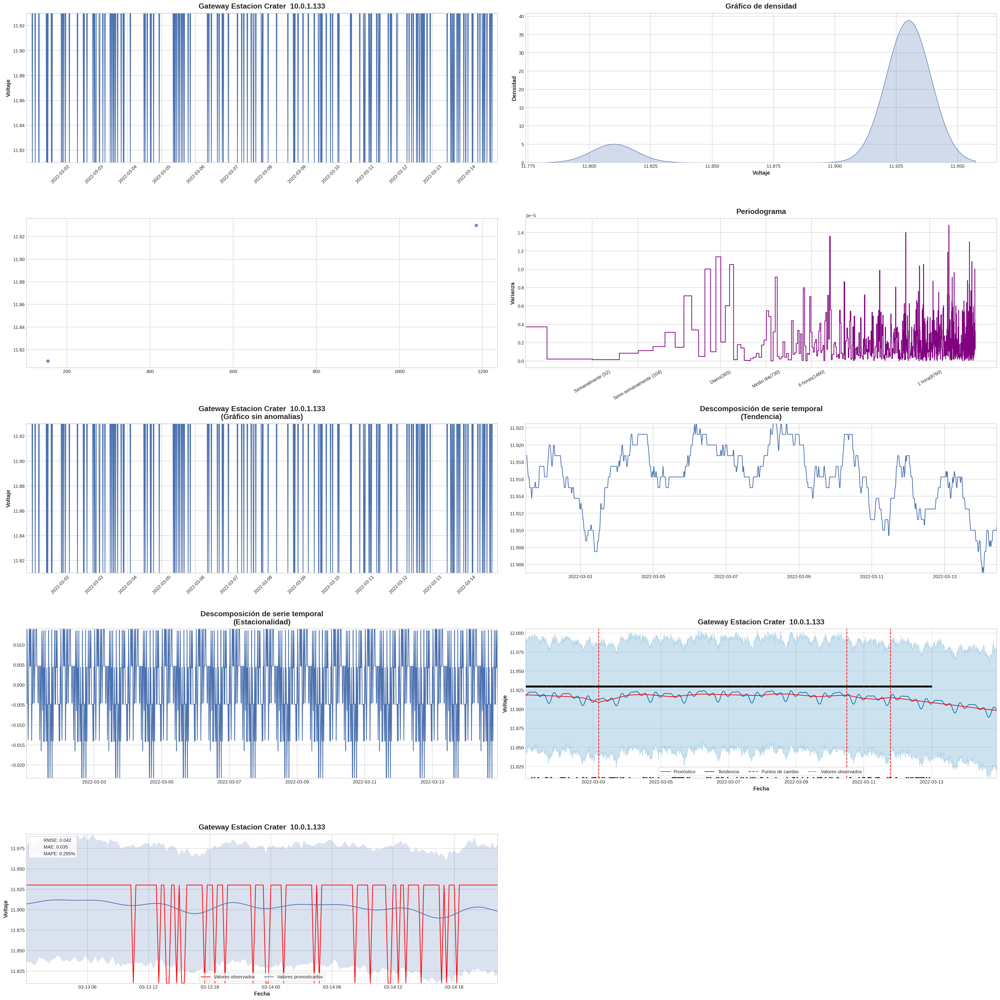

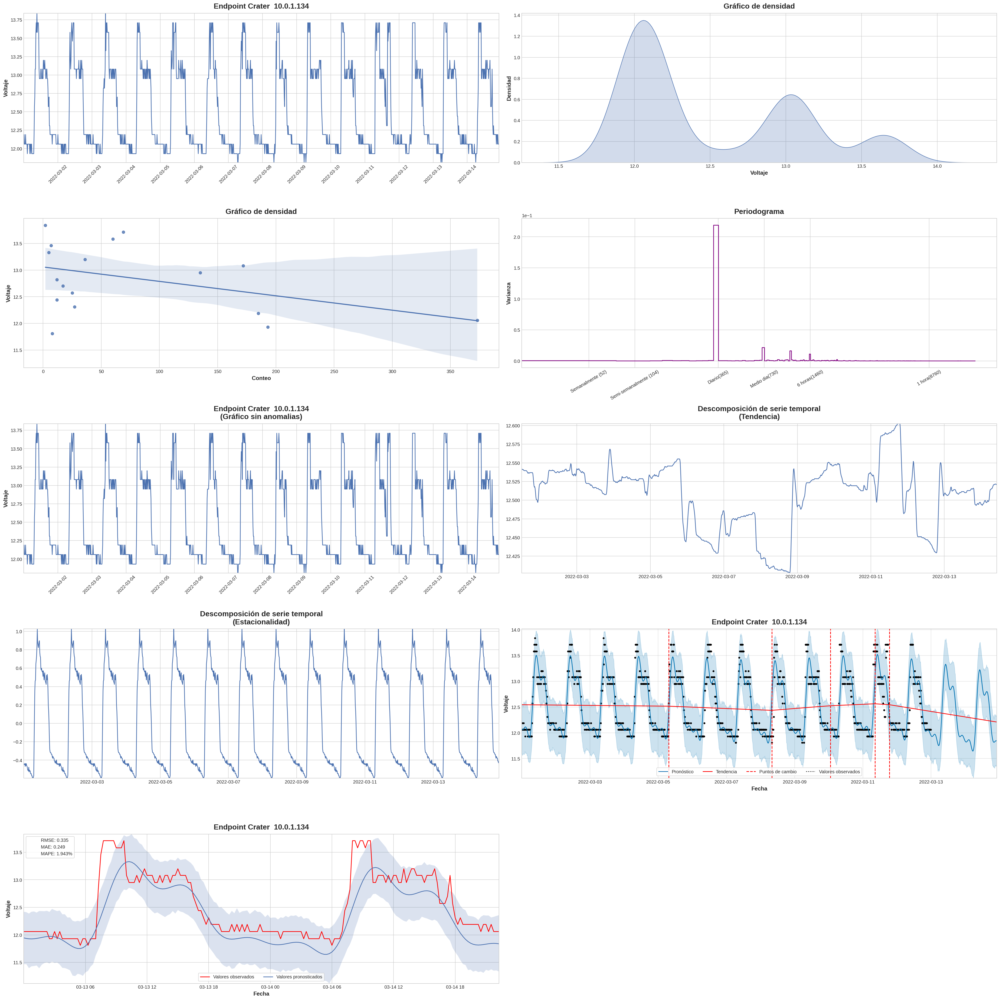

An exception occurred


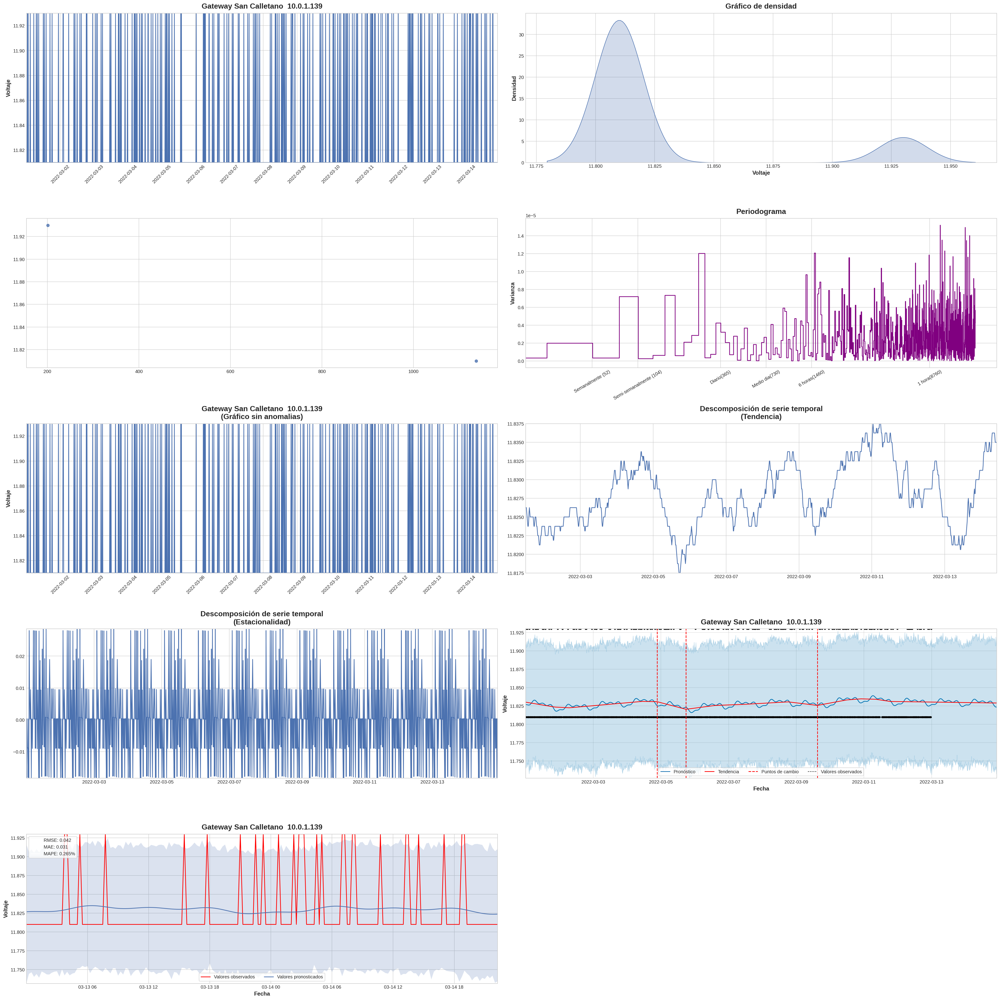

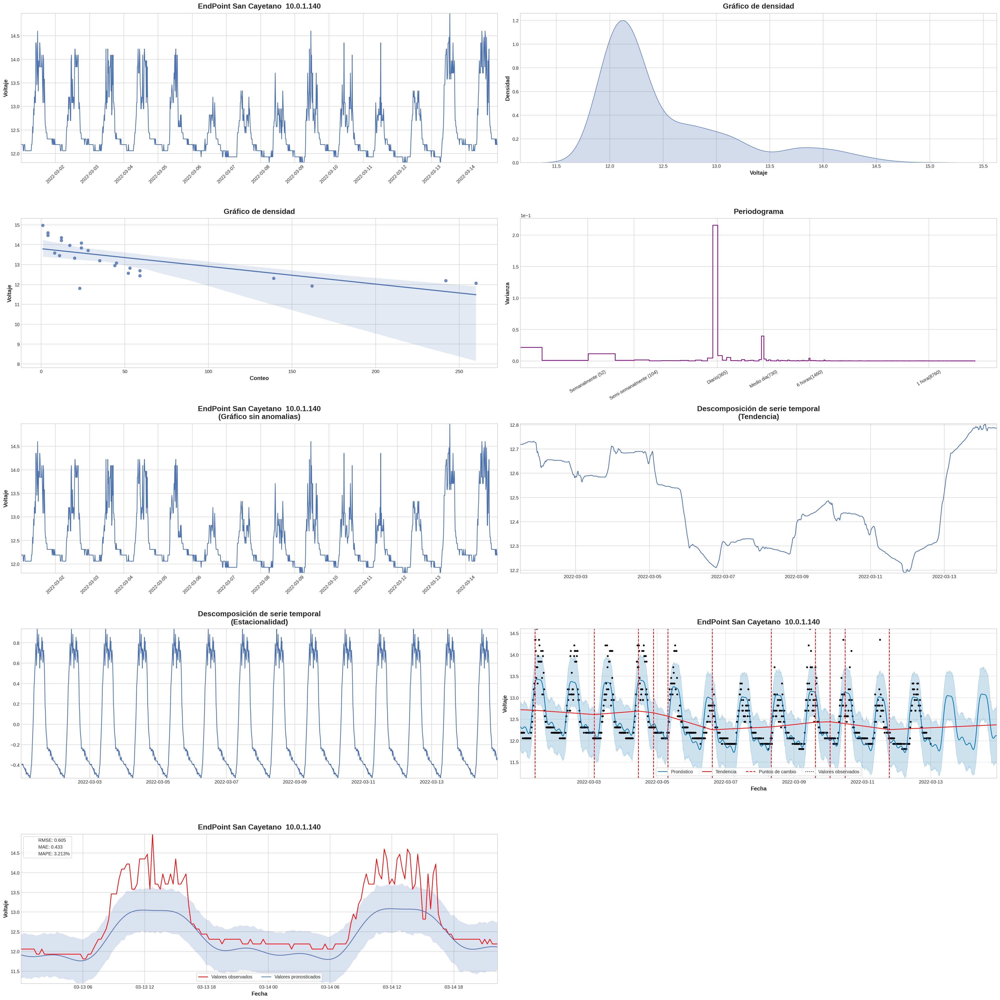

In [20]:
for region, df_region in df.groupby('ip_fre'):
    plt.figure()
    fig = plt.subplot(5, 2, 1)
    visualización(df_region, fig)
    plt.subplot(5, 2, 2)
    outliers(df_region)
    fig1=plt.subplot(5, 2, 3)
    outliers_lineal(df_region)
    fig2=plt.subplot(5, 2, 5)    
    df_regionM = remove_outliers(df_region, fig2)
    fig3= plt.subplot(5, 2, 4)
    plot_periodogram(df_regionM.vol_fre, ax=fig3);
    fig4= plt.subplot(5, 2, 6)
    descomposition(df_regionM, plt)
    fig5 = plt.subplot(5, 2, 8)
    forecast(df_regionM, fig5)
    
    if df_region["ip_fre"].iat[0] == "10.0.1.140": break
    